## Tarefa 7 - Árvore de Decisão
**Nome:** Gabriel Martins Machado Christo **DRE:** 117217732

**Nome:** João Vitor de Freitas Barbosa **DRE:** 117055449


In [ ]:
## Montando drive para acessar dataset
#from google.colab import drive
#drive.mount('/content/drive')

## Tambem eh possivel realizar upload do arquivo inves de montar o drive

In [ ]:
# Imports
import pandas as pd
from sklearn.tree import DecisionTreeClassifier, export_graphviz
from sklearn import metrics, preprocessing, utils
from sklearn.model_selection import KFold, train_test_split
from six import StringIO  
from IPython.display import Image  
import pydotplus
import numpy as np

In [ ]:
# leitura do dataset
col_names = ['Poster_Link','Series_Title','Released_Year','Certificate','Runtime','Genre','IMDB_Rating','Overview','Meta_score','Director','Star1','Star2','Star3','Star4','No_of_Votes','Gross']
data = pd.read_csv("imdb_top_1000.csv", header=0, names=col_names, nrows=510)

In [ ]:
## Adaptação de alguma colunas para correta discretização e interpretação pelo sklearn

# alterando coluna de nota do imdb de float para int
data['IMDB_Rating'] = data['IMDB_Rating'].apply(lambda x: int(10*x))

# alterando coluna de meta score para int e preenchendo linhas vazias
data['Meta_score'] = data['Meta_score'].apply(lambda x: 0 if np.isnan(x) else x)
data['Meta_score'] = data['Meta_score'].apply(lambda x: int(x))

# visando apenas o genero principal do filme
data['Genre'] = data['Genre'].apply(lambda x: x.split(',')[0])

# removendo caracteres da coluna de duracao do filme
data['Runtime'] = data['Runtime'].apply(lambda x: ''.join(filter(str.isdigit, str(x))))

# preenchendo linhas vazias da coluna gross
data['Gross'] = data['Gross'].apply(lambda x: 0 if np.isnan(x) else int(x))

data.head()

,Poster_Link,Series_Title,Released_Year,Certificate,Runtime,Genre,IMDB_Rating,Overview,Meta_score,Director,Star1,Star2,Star3,Star4,No_of_Votes,Gross
0,https://m.media-amazon.com/images/M/MV5BMDFkYT...,The Shawshank Redemption,1994,A,142,Drama,93,Two imprisoned men bond over a number of years...,80,Frank Darabont,Tim Robbins,Morgan Freeman,Bob Gunton,William Sadler,2343110,28341469
1,https://m.media-amazon.com/images/M/MV5BM2MyNj...,The Godfather,1972,A,175,Crime,92,An organized crime dynasty's aging patriarch t...,100,Francis Ford Coppola,Marlon Brando,Al Pacino,James Caan,Diane Keaton,1620367,134966411
2,https://m.media-amazon.com/images/M/MV5BMTMxNT...,The Dark Knight,2008,UA,152,Action,90,When the menace known as the Joker wreaks havo...,84,Christopher Nolan,Christian Bale,Heath Ledger,Aaron Eckhart,Michael Caine,2303232,534858444
3,https://m.media-amazon.com/images/M/MV5BMWMwMG...,The Godfather: Part II,1974,A,202,Crime,90,The early life and career of Vito Corleone in ...,90,Francis Ford Coppola,Al Pacino,Robert De Niro,Robert Duvall,Diane Keaton,1129952,57300000
4,https://m.media-amazon.com/images/M/MV5BMWU4N2...,12 Angry Men,1957,U,96,Crime,90,A jury holdout attempts to prevent a miscarria...,96,Sidney Lumet,Henry Fonda,Lee J. Cobb,Martin Balsam,John Fiedler,689845,4360000


In [ ]:
def plotTree(filename, classifier, used_feature):
  picture = StringIO()
  try:
    export_graphviz(classifier, out_file=picture, filled=True, rounded=True, special_characters=True, feature_names = used_feature.columns)
  except NameError: print(NameError)
  graph = pydotplus.graph_from_dot_data(picture.getvalue())  
  graph.write_png(filename)
  arv = graph.create_png()
  return arv

In [ ]:
def executaExperimento(colunas, conceito, criterio, maxDepth, fileName):
  # selecionamos as colunas correspondentes aos atributos que serão usados
  x = data[colunas]

  # coluna com conceito desejado. Selecionamos a coluna com a classificação das instâncias
  y = conceito

  # adaptando entradas categóricas em valores discretos pelo framework pandas
  handled_data = pd.get_dummies(x[colunas])

  # Criação do classificador de árvore de decisão 
  clf = DecisionTreeClassifier(criterion = criterio, max_depth = maxDepth)

  # Usamos o método fit para construir o classificador a partir do nosso conjunto de treinamento
  clf = clf.fit(handled_data, y)

  img = plotTree(fileName, clf, handled_data)

  # Usando modelo para classificar os dados que temos a disposição
  y_pred = clf.predict(handled_data)

  # Medida de acuracia, que indica quantas instâncias são corretamente classificadas
  print("Accuracy:", metrics.accuracy_score(y, y_pred))

  return img

In [ ]:
def executaExperimentoXY(colunas, conceito, criterio, maxDepth, fileName, train, test):
  x = data[colunas]
  y = conceito
  handled_data = pd.get_dummies(x[colunas])
  # Tambem podemos rodar o experimento base dividindo o conjunto de dados em treinamento/teste
  # Para o proximo teste foi utilizado 60% treinamento e 40% teste
  X1_train, X1_test, y1_train, y1_test = train_test_split(handled_data, y, test_size = test, train_size= train, random_state=None, shuffle=True, stratify=None)
  clf = DecisionTreeClassifier(criterion = criterio, max_depth = maxDepth)

  clf = clf.fit(X1_train, y1_train)
  img1 = plotTree(fileName, clf, handled_data)

  # Usando modelo para classificar os dados que temos a disposição
  y_pred = clf.predict(handled_data)
  y_train = metrics.accuracy_score(y, y_pred)
  print("Accuracy Train:", y_train)

  return img1

In [ ]:
def executaKFold(colunas, conceito, criterio, maxDepth, folds):
  x = data[colunas]
  y = conceito
  handled_data = pd.get_dummies(x[colunas])
  kf = KFold(n_splits=folds, shuffle=False)
  data_array = handled_data.to_numpy()
  acuracias = []
  clf = DecisionTreeClassifier(criterion = criterio, max_depth = maxDepth)
  for train_index, test_index in kf.split(data_array):
    X_train, X_test = data_array[train_index], data_array[test_index]
    Y_train, Y_test = y[train_index], y[test_index]
    clf = clf.fit(X_train, Y_train)
    acuracias.append(metrics.accuracy_score(conceito, clf.predict(handled_data.values)))

  return sum(acuracias)/len(acuracias)

Accuracy: 0.4019607843137255


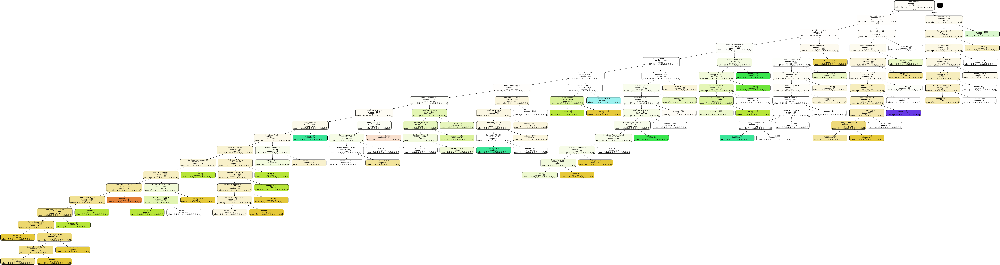

In [ ]:
### EXPERIMENTO BASE (entropy) ###
r = executaExperimento(['Genre', 'Certificate'], data.IMDB_Rating, "entropy", 50, "tree_1.png")
Image(r)

Accuracy Train: 0.3686274509803922


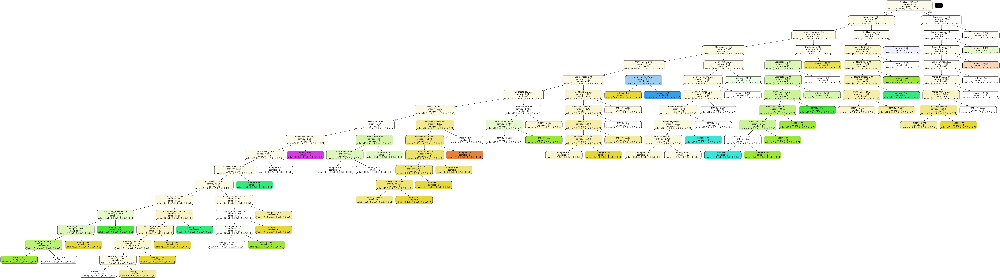

In [ ]:
### EXPERIMENTO BASE (60/40 entropy) ###
r = executaExperimentoXY(['Genre', 'Certificate'], data.IMDB_Rating, "entropy", 50, "tree_2.png", 0.6, 0.4)
Image(r)

Accuracy Train: 0.3843137254901961


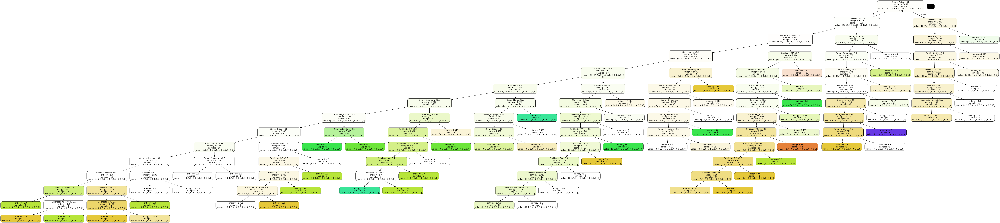

In [ ]:
### EXPERIMENTO BASE (80/20 entropy) ###
r = executaExperimentoXY(['Genre', 'Certificate'], data.IMDB_Rating, "entropy", 50, "tree_2.png", 0.8, 0.2)
Image(r)

In [ ]:
### EXPERIMENTO BASE (kfold entropy) ###
fold_number = 10
r = executaKFold(['Genre', 'Certificate'], data.IMDB_Rating, "entropy", 50, fold_number)
print(f"Media da precisao de treino com kfolds: {r}, utilizando {fold_number} folds")

Media da precisao de treino com kfolds: 0.38764705882352934, utilizando 10 folds


In [ ]:
### EXPERIMENTO ALTERNATIVO (entropy) ###
r = executaExperimento(['Genre', 'Certificate', 'Runtime'], data.IMDB_Rating, "entropy", 50, "tree_1.png")
Image(r)

Accuracy: 0.9411764705882353


In [ ]:
### EXPERIMENTO ALTERNATIVO (60/40 entropy) ###
r = executaExperimentoXY(['Genre', 'Certificate', 'Runtime'], data.IMDB_Rating, "entropy", 50, "tree_2.png", 0.6, 0.4)
Image(r)

Accuracy Train: 0.692156862745098


In [ ]:
### EXPERIMENTO ALTERNATIVO (80/20 entropy) ###
r = executaExperimentoXY(['Genre', 'Certificate', 'Runtime'], data.IMDB_Rating, "entropy", 50, "tree_2.png", 0.8, 0.2)
Image(r)

Accuracy Train: 0.8137254901960784


In [ ]:
### EXPERIMENTO ALTERNATIVO (kfold entropy) ###
fold_number = 10
r = executaKFold(['Genre', 'Certificate', 'Runtime'], data.IMDB_Rating, "entropy", 50, fold_number)
print(f"Media da precisao de treino com kfolds: {r}, utilizando {fold_number} folds")

Media da precisao de treino com kfolds: 0.8633333333333335, utilizando 10 folds
